In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

import anndata as ad
import scanpy as sc

from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from umap import UMAP

from scroutines import powerplots

import importlib
importlib.reload(powerplots)
from scroutines import basicu
from scroutines.miscu import is_in_polygon

import utils_merfish

In [2]:
np.random.seed(0)

In [3]:
# functions (the teacher wrote for you to use later)
def rot2d(x, y, theta, unit='degree'):
    """ rotate data points defined by `x` and `y` by `theta` degree
    """
    a = np.vstack([x,y]).T
    if unit == 'degree':
        theta = theta*np.pi/180 # convert to radian

    R = np.array([[np.cos(theta), -np.sin(theta)], [np.sin(theta), np.cos(theta)]])
    ar = a.dot(R.T)
    return ar[:,0], ar[:,1]

def st_scatter(x, y, gexp=None, vmax_p=98, unit_norm=False, 
               title='', s=1, cbar_label='', output='', cmap='rocket_r', axis_off=True, 
               vmin=None, **cbar_kwargs):
    """customized scatter plot -- yesterday's progress
    """
    from mpl_toolkits.axes_grid1 import make_axes_locatable
  
    fig, ax = plt.subplots(figsize=(10,8))
    if gexp is not None:
        vmax = np.percentile(gexp, vmax_p)
        if unit_norm:
            rgexp = gexp/vmax
            g = ax.scatter(x, y, c=rgexp, s=s, edgecolor='none', vmin=vmin, vmax=1, cmap=cmap, rasterized=True)
            fig.colorbar(g, label=cbar_label, shrink=0.3, **cbar_kwargs)
            title = title + f" (max {vmax:.2g} at {vmax_p:.2g} pctl)"
        else:
            g = ax.scatter(x, y, c=gexp, s=s, edgecolor='none', vmin=vmin, vmax=vmax, cmap=cmap, rasterized=True)
            fig.colorbar(g, label=cbar_label, shrink=0.3, **cbar_kwargs)
    else:
        g = ax.scatter(x, y, s=s, edgecolor='none', cmap=cmap, rasterized=True)
  
    if axis_off:
        ax.axis('off')
    ax.set_title(title)
    ax.set_aspect('equal')
  
    if output:
        powerplots.savefig_autodate(fig, output)
        
    return 

def st_scatter_ax(ax, x, y, gexp=None, vmax_p=98, unit_norm=False, 
               title='', s=1, cbar_label='', cmap='rocket_r', axis_off=True, 
               vmin=None, **cbar_kwargs):
    """customized scatter plot -- yesterday's progress
    """
    from mpl_toolkits.axes_grid1 import make_axes_locatable
  
    if gexp is not None:
        vmax = np.percentile(gexp, vmax_p)
        if unit_norm:
            rgexp = gexp/vmax
            g = ax.scatter(x, y, c=rgexp, s=s, edgecolor='none', vmin=vmin, vmax=1, cmap=cmap, rasterized=True)
            fig.colorbar(g, label=cbar_label, shrink=0.3, **cbar_kwargs)
            title = title + f" (max {vmax:.2g} at {vmax_p:.2g} pctl)"
        else:
            g = ax.scatter(x, y, c=gexp, s=s, edgecolor='none', vmin=vmin, vmax=vmax, cmap=cmap, rasterized=True)
            fig.colorbar(g, label=cbar_label, shrink=0.3, **cbar_kwargs)
    else:
        g = ax.scatter(x, y, s=s, edgecolor='none', cmap=cmap, rasterized=True)
  
    if axis_off:
        ax.axis('off')
    ax.set_title(title)
    ax.set_aspect('equal')
  
    return 

# visualize clusters
def plot_cluster(clsts, x, y, ux, uy, s=1, axis_off=True):
    """this assumes `clsts` is a integer that starts from 0
    """
    from matplotlib import colors
  
    unq_clsts, inv = np.unique(clsts, return_inverse=True)
    n_unq = len(unq_clsts)
    # colors = np.array(sns.color_palette('husl', n_unq))
    # c_vec = colors[inv]
  
    cmap = plt.cm.jet
    norm = colors.BoundaryNorm(np.arange(-0.5, n_unq, 1), cmap.N)
  
    fig, axs = plt.subplots(1, 2, figsize=(8*2,6))
    
    ax = axs[0]
    g = ax.scatter(x, y, norm=norm, cmap=cmap, c=clsts, s=s, edgecolor='none')
    ax.set_title('XY (spatial distribution)')
    ax.set_aspect('equal')
    if axis_off:
        ax.axis('off')
    
    ax = axs[1]
    ax.scatter(ux, uy, norm=norm, cmap=cmap, c=clsts, s=s, edgecolor='none')
    ax.set_title('UMAP (molecular similarity)')
    ax.set_aspect('equal')
    if axis_off:
        ax.axis('off')
  
    fig.colorbar(g, ax=ax, label='clusters', ticks=np.arange(n_unq), shrink=0.7)
    return fig, axs

In [4]:
def binning_pipe(adata, n=20, layer='lnorm', bin_type='depth_bin'):
    """
    """
    assert bin_type in ['depth_bin', 'width_bin']
    # bin it 
    depth_bins, depth_binned = utils_merfish.binning(adata.obs['depth'].values, n)
    width_bins, width_binned = utils_merfish.binning(adata.obs['width'].values, n)

    norm_ = pd.DataFrame(adata.layers[layer], columns=adata.var.index)
    norm_['depth_bin'] = depth_binned
    norm_['width_bin'] = width_binned
    
    norm_mean = norm_.groupby(bin_type).mean(numeric_only=True)
    norm_sem  = norm_.groupby(bin_type).sem(numeric_only=True)
    norm_std  = norm_.groupby(bin_type).std(numeric_only=True)
    norm_n    = norm_[bin_type].value_counts(sort=False)

    return norm_mean, norm_sem, norm_std, norm_n, depth_binned, width_binned, depth_bins, width_bins

In [5]:
outdir = "/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results_merfish/plots_240228"
outdatadir = "/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results_merfish"
!mkdir -p $outdir

In [6]:
from merfish_datasets import merfish_datasets
directories = merfish_datasets

keys = [
    'P14NR_ant', 
    'P14NR_pos',
    
    'P28NR_ant', 
    'P28NR_pos',
    
    'P21NR_ant', 
    'P21NR_pos',

    'P21DR_ant', 
    'P21DR_pos',
    
    'P28DR_ant', 
    'P28DR_pos',
]

ddir = "/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/data/merfish/organized" 
!ls $ddir 

P14NR_ant_ctxglut_240307.h5ad  P21NR_pos_ctxglut_240307.h5ad
P14NR_pos_ctxglut_240307.h5ad  P28DR_ant_ctxglut_240307.h5ad
P21DR_ant_ctxglut_240307.h5ad  P28DR_pos_ctxglut_240307.h5ad
P21DR_pos_ctxglut_240307.h5ad  P28NR_ant_ctxglut_240307.h5ad
P21NR_ant_ctxglut_240307.h5ad  P28NR_pos_ctxglut_240307.h5ad


In [7]:
%%time
alldata = {}

for name in keys:
    print(name)
    alldata[name] = ad.read(os.path.join(ddir, f'{name}_ctxglut_240307.h5ad'))
    
# name = 'P14NR_ant'
# adata = ad.read(os.path.join(ddir, f'{name}_ctxglut_240307.h5ad'))
# adata

P14NR_ant
P14NR_pos
P28NR_ant
P28NR_pos
P21NR_ant
P21NR_pos
P21DR_ant
P21DR_pos
P28DR_ant
P28DR_pos
CPU times: user 1.04 s, sys: 1.71 s, total: 2.75 s
Wall time: 19.7 s


P14NR_ant


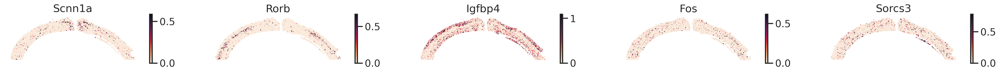

P14NR_pos


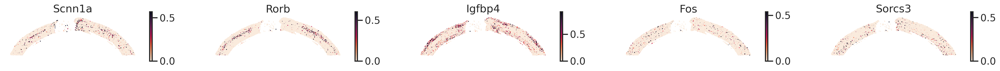

P28NR_ant


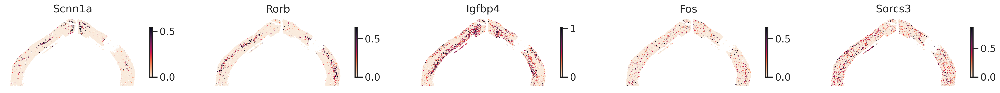

P28NR_pos


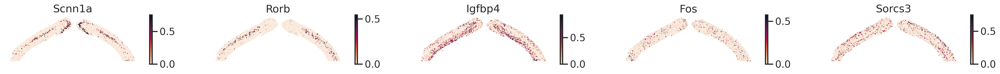

P21NR_ant


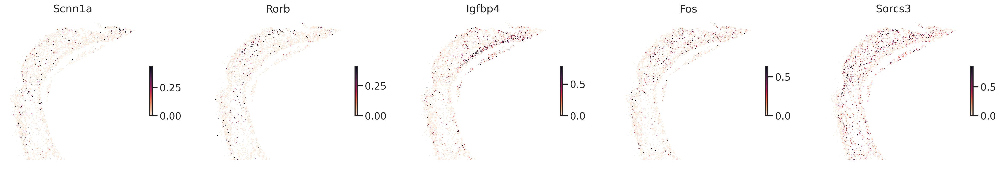

P21NR_pos


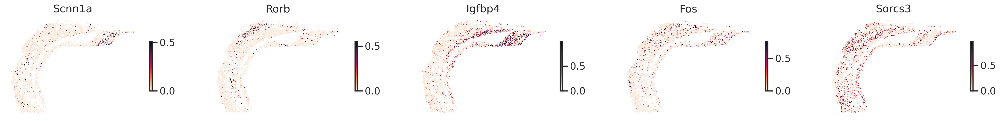

P21DR_ant


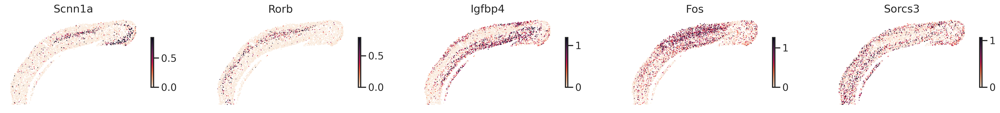

P21DR_pos


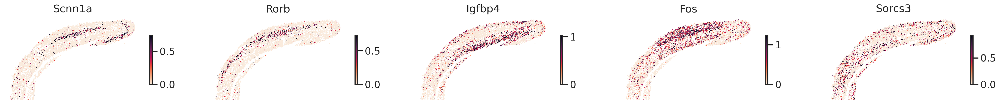

P28DR_ant


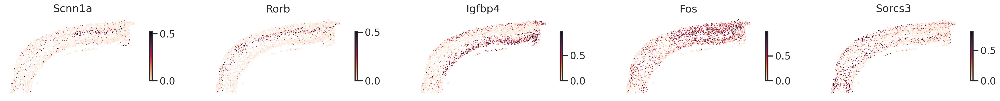

P28DR_pos


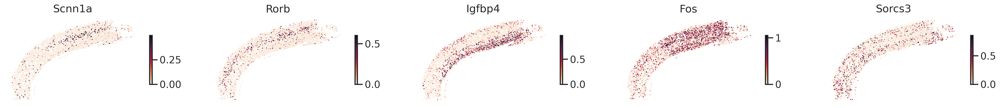

In [8]:
for name, adata in alldata.items():
    print(name)
    gns = ['Scnn1a', 'Rorb', 'Igfbp4', 'Fos', 'Sorcs3']
    x = adata.obs['x']
    y = adata.obs['y']
    n = len(gns)

    fig, axs = plt.subplots(1,n,figsize=(n*6,1*5))
    for ax, gn in zip(axs, gns):
        # gn = 'Scnn1a'
        g = np.log10(1+adata[:,gn].layers['norm'])
        st_scatter_ax(ax, x, y, gexp=g, s=2, title=gn)

    plt.show()

# just P28NR and P28DR

P28NR_ant


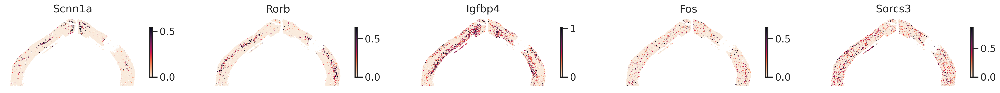

P28NR_pos


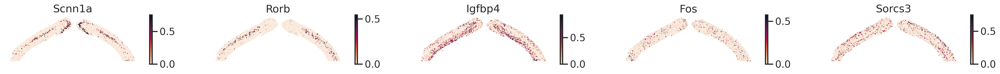

P28DR_ant


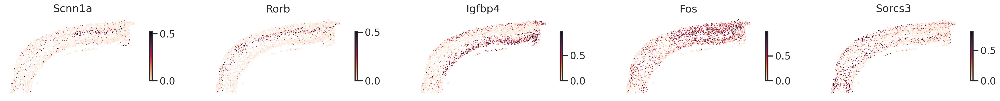

P28DR_pos


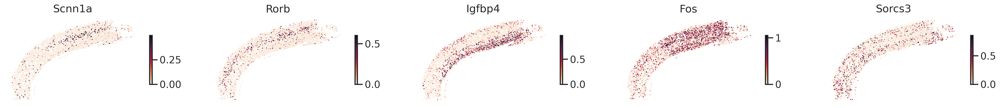

In [9]:

gns = ['Scnn1a', 'Rorb', 'Igfbp4', 'Fos', 'Sorcs3']
for name in ['P28NR_ant', 'P28NR_pos', 'P28DR_ant', 'P28DR_pos']:
    adata = alldata[name]
    print(name)
    x = adata.obs['x']
    y = adata.obs['y']
    n = len(gns)

    fig, axs = plt.subplots(1,n,figsize=(n*6,1*5))
    for ax, gn in zip(axs, gns):
        # gn = 'Scnn1a'
        g = np.log10(1+adata[:,gn].layers['norm'])
        st_scatter_ax(ax, x, y, gexp=g, s=2, title=gn)

    plt.show()

# filter based on locations
- left hemi-brain
- label v1 L2/3 


In [10]:


filtered_data = {}

name = 'P28NR_ant'
adata = alldata[name]
cond = adata.obs['width'] < 8000
adatasub = adata[cond]
filtered_data[name] = adatasub

name = 'P28NR_pos'
adata = alldata[name]
cond = adata.obs['width'] < 7000
adatasub = adata[cond]
filtered_data[name] = adatasub

name = 'P28DR_ant'
adata = alldata[name]
adatasub = adata
filtered_data[name] = adatasub

name = 'P28DR_pos'
adata = alldata[name]
adatasub = adata
filtered_data[name] = adatasub


v1l23_data = {}
name = 'P28NR_ant'
adata = alldata[name]
cond = np.all([
    adata.obs['width'] > 4200, 
    adata.obs['width'] < 5400, 
    adata.obs['depth'] < 300, 
], axis=0)
adatasub = adata[cond]
v1l23_data[name] = adatasub

name = 'P28NR_pos'
adata = alldata[name]
cond = np.all([
    adata.obs['width'] > 2900, 
    adata.obs['width'] < 4900, 
    adata.obs['depth'] < 300, 
], axis=0)
adatasub = adata[cond]
v1l23_data[name] = adatasub

name = 'P28DR_ant'
adata = alldata[name]
cond = np.all([
    adata.obs['width'] > 4000, 
    adata.obs['width'] < 6000, 
    adata.obs['depth'] < 300, 
], axis=0)
adatasub = adata[cond]
v1l23_data[name] = adatasub

name = 'P28DR_pos'
adata = alldata[name]
cond = np.all([
    adata.obs['width'] > 4000, 
    adata.obs['width'] < 5900, 
    adata.obs['depth'] < 300, 
], axis=0)
adatasub = adata[cond]
v1l23_data[name] = adatasub

P28NR_ant


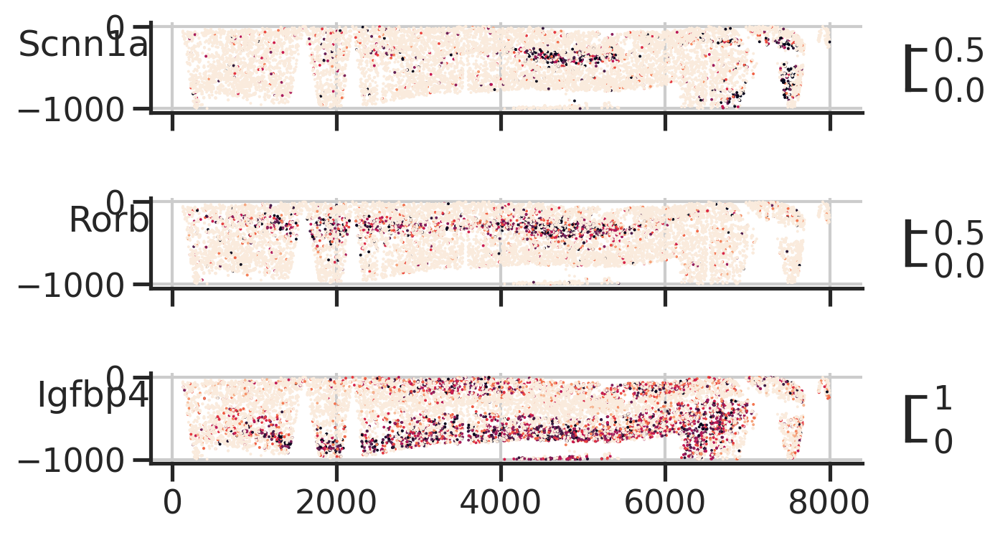

P28NR_pos


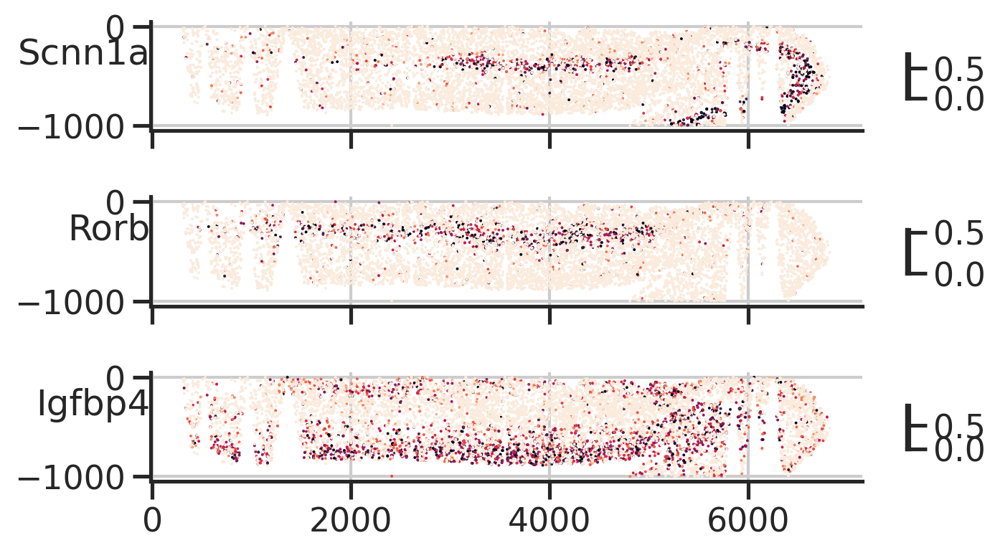

P28DR_ant


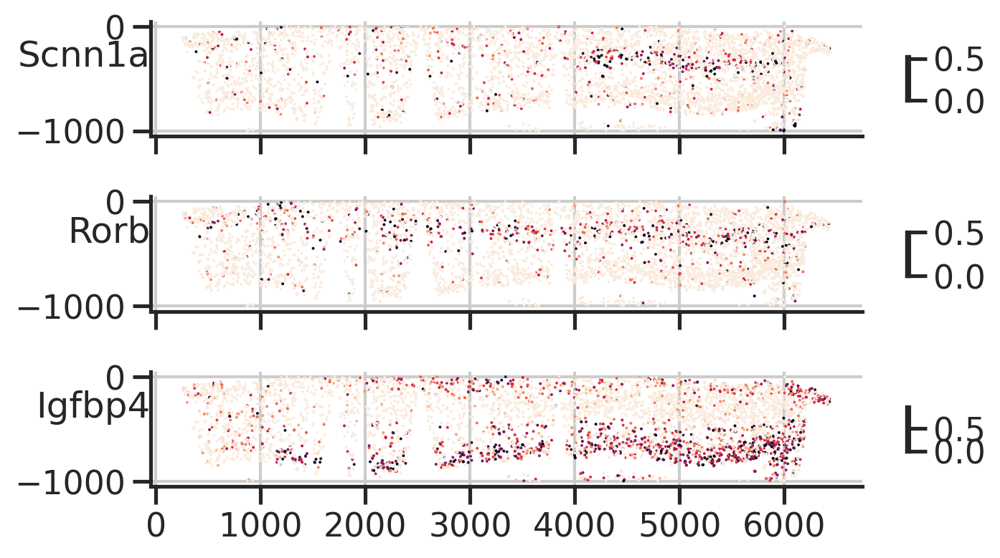

P28DR_pos


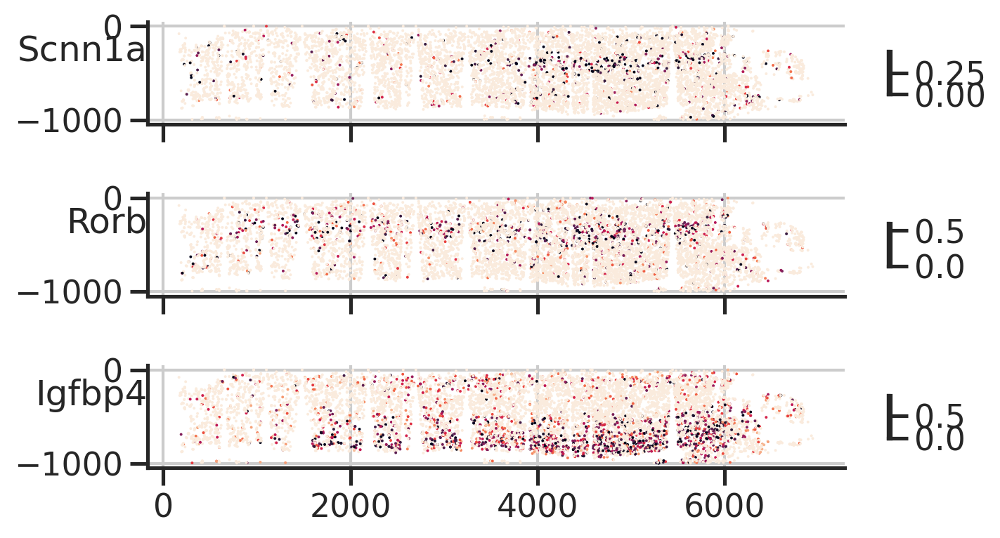

In [11]:
selected_sections = ['P28NR_ant', 'P28NR_pos', 'P28DR_ant', 'P28DR_pos']

gns = ['Scnn1a', 'Rorb', 'Igfbp4', ]
for name in selected_sections:
    adata = filtered_data[name]
    print(name)

    adatasub = adata 
    x =  adatasub.obs['width']
    y = -adatasub.obs['depth']
    n = len(gns)

    fig, axs = plt.subplots(n,1,figsize=(1*8,n*1.5), sharex=True, sharey=True)
    for ax, gn in zip(axs, gns):
        # gn = 'Scnn1a'
        g = np.log10(1+adatasub[:,gn].layers['norm'])
        st_scatter_ax(ax, x, y, gexp=g, s=2, title="")
        ax.set_title(gn, loc='left', ha='right', y=0.5)
        ax.grid(True)
        ax.axis('on')
        sns.despine()
    plt.show()


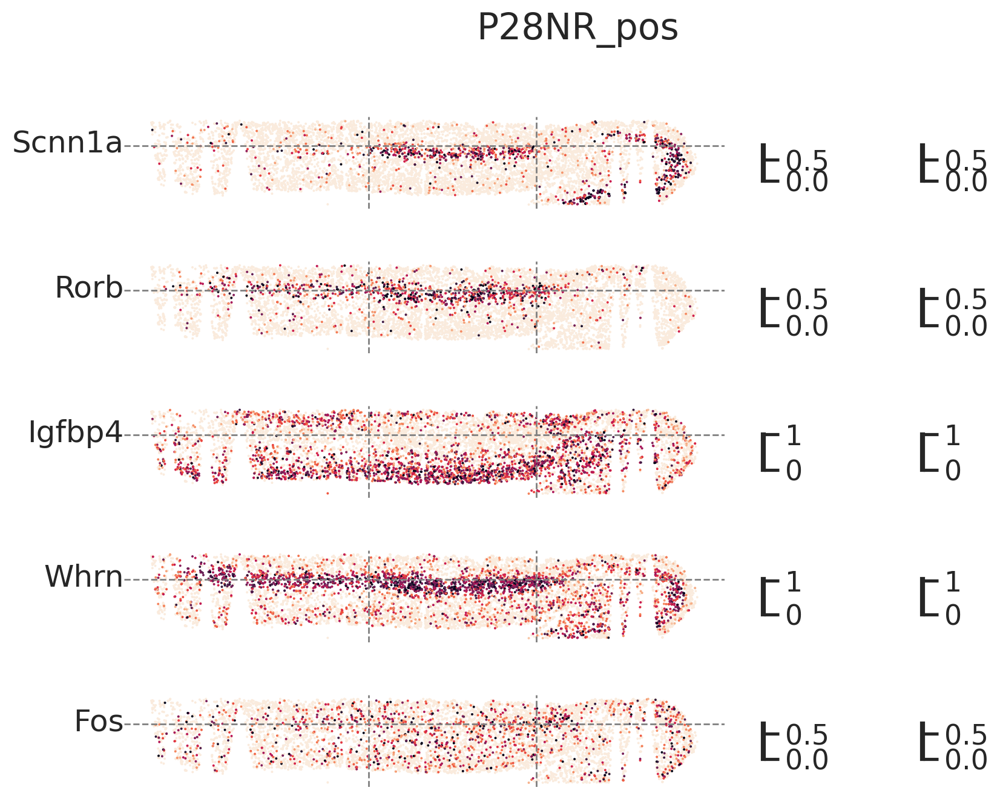

In [12]:
gns = ['Scnn1a', 'Rorb', 'Igfbp4', 'Whrn', 'Fos'] # 'Cdh13', 'Sorcs3', 'Chrm2', 'Astn2', 'Fos']

name = 'P28NR_ant' 
bound_l, bound_r, bound_d = 4200, 5400, 300

name = 'P28NR_pos' 
bound_l, bound_r, bound_d = 2900, 4900, 300

# name = 'P28DR_ant' 
# bound_l, bound_r, bound_d = 4000, 6000, 300

# name = 'P28DR_pos' 
# bound_l, bound_r, bound_d = 4000, 5900, 300

adata = filtered_data[name]
x =  adata.obs['width']
y = -adata.obs['depth']
n = len(gns)

fig, axs = plt.subplots(n,1,figsize=(1*10,n*1.5))
fig.suptitle(name)
for ax, gn in zip(axs, gns):
    # gn = 'Scnn1a'
    g = np.log10(1+adata[:,gn].layers['norm']).reshape(-1,)
    
    vmax = np.percentile(g, 99)
    vmin = np.percentile(g,  5)
    cond = g > 1e-5
    
    utils_merfish.st_scatter_ax(fig, ax, x[~cond], y[~cond], gexp=g[~cond], s=2, title='', vmin=vmin, vmax=vmax, cmap='rocket_r') #, axis_off=False)
    utils_merfish.st_scatter_ax(fig, ax,  x[cond],  y[cond],  gexp=g[cond], s=2, title='', vmin=vmin, vmax=vmax, cmap='rocket_r') #, axis_off=False)
    
    ax.set_title(gn, loc='left', ha='right', y=0.5)
    ax.axhline(-bound_d, linestyle='--', linewidth=1, color='gray', zorder=2)
    ax.axvline( bound_l, linestyle='--', linewidth=1, color='gray', zorder=2)
    ax.axvline( bound_r, linestyle='--', linewidth=1, color='gray', zorder=2)
    # ax.grid(True)
    # ax.axis('on')
    
plt.show()

P28NR_ant


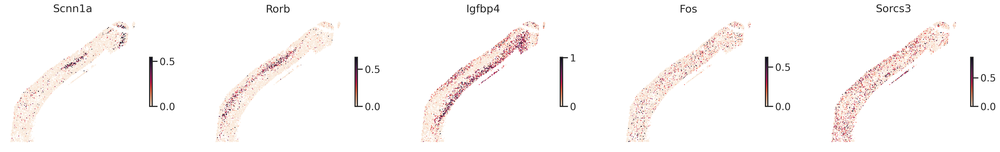

P28NR_pos


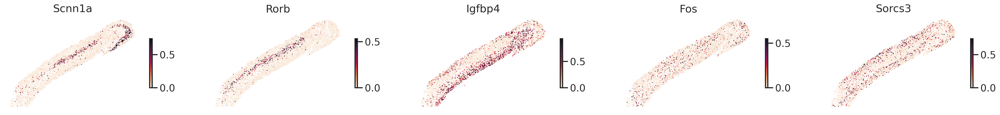

P28DR_ant


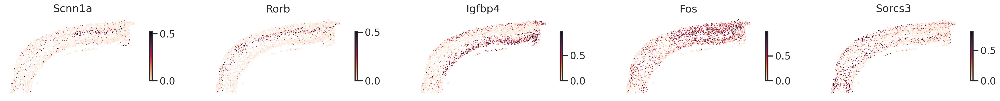

P28DR_pos


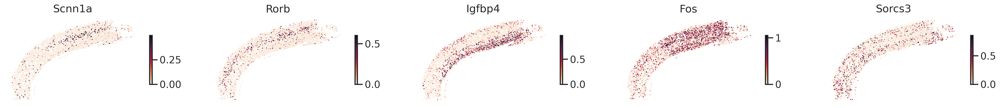

In [13]:
gns = ['Scnn1a', 'Rorb', 'Igfbp4', 'Fos', 'Sorcs3']
for name in selected_sections:
    adata = filtered_data[name]
    print(name)
    x = adata.obs['x']
    y = adata.obs['y']
    n = len(gns)

    fig, axs = plt.subplots(1,n,figsize=(n*6,1*5))
    for ax, gn in zip(axs, gns):
        # gn = 'Scnn1a'
        g = np.log10(1+adata[:,gn].layers['norm'])
        st_scatter_ax(ax, x, y, gexp=g, s=2, title=gn)

    plt.show()

P28NR_ant


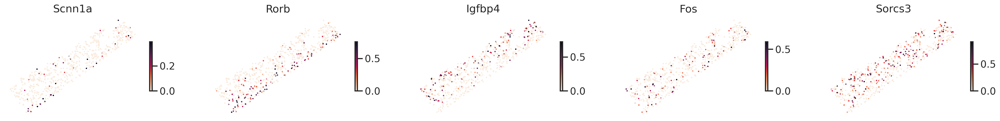

P28NR_pos


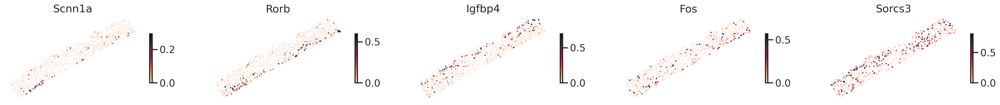

P28DR_ant


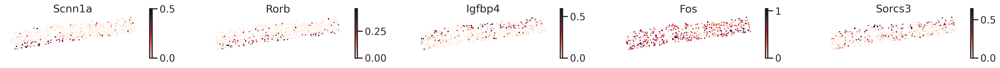

P28DR_pos


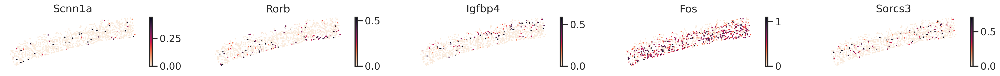

In [14]:
gns = ['Scnn1a', 'Rorb', 'Igfbp4', 'Fos', 'Sorcs3']
for name in selected_sections:
    adata = v1l23_data[name]
    print(name)
    x = adata.obs['x']
    y = adata.obs['y']
    n = len(gns)

    fig, axs = plt.subplots(1,n,figsize=(n*6,1*5))
    for ax, gn in zip(axs, gns):
        # gn = 'Scnn1a'
        g = np.log10(1+adata[:,gn].layers['norm'])
        st_scatter_ax(ax, x, y, gexp=g, s=5, title=gn)

    plt.show()

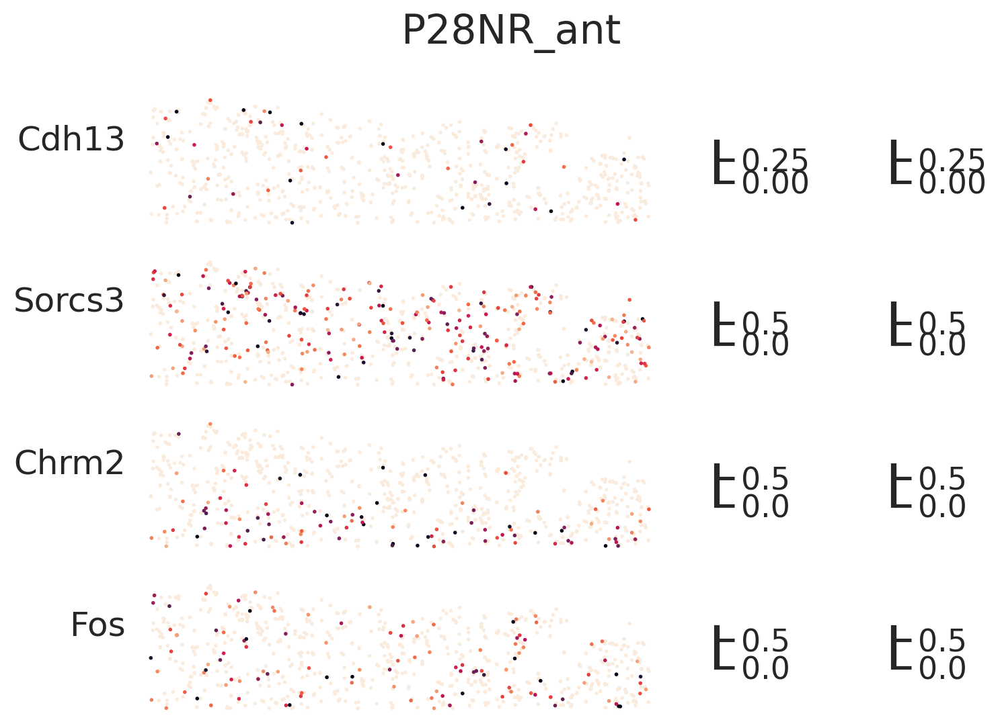

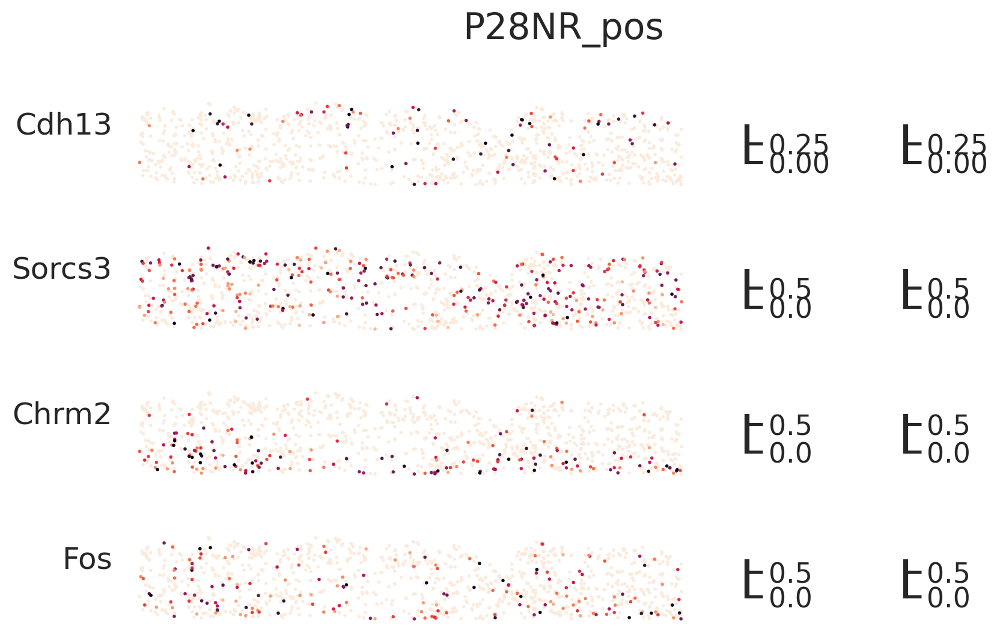

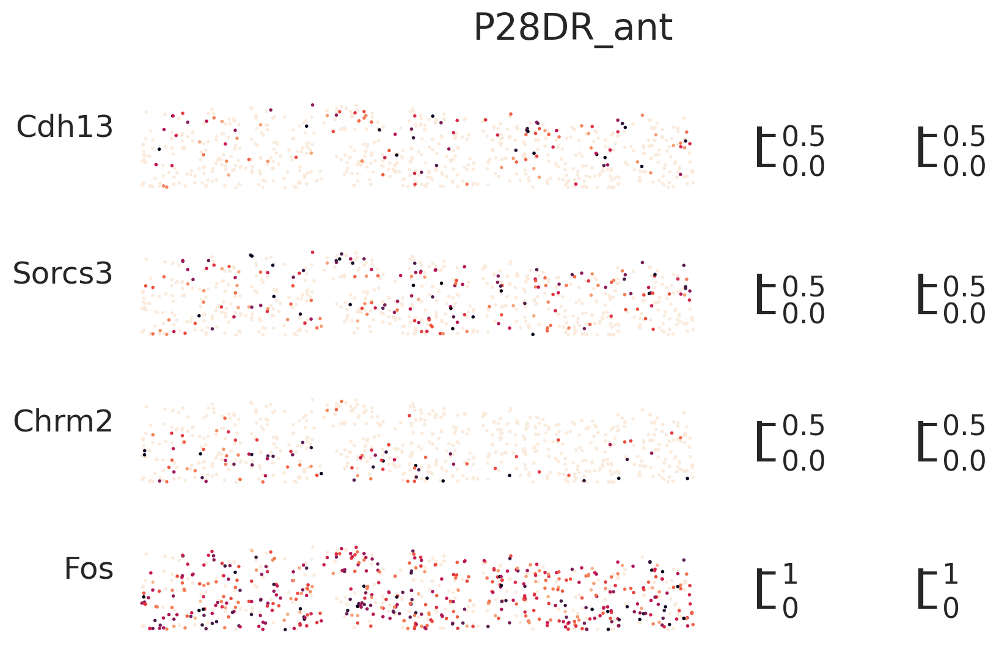

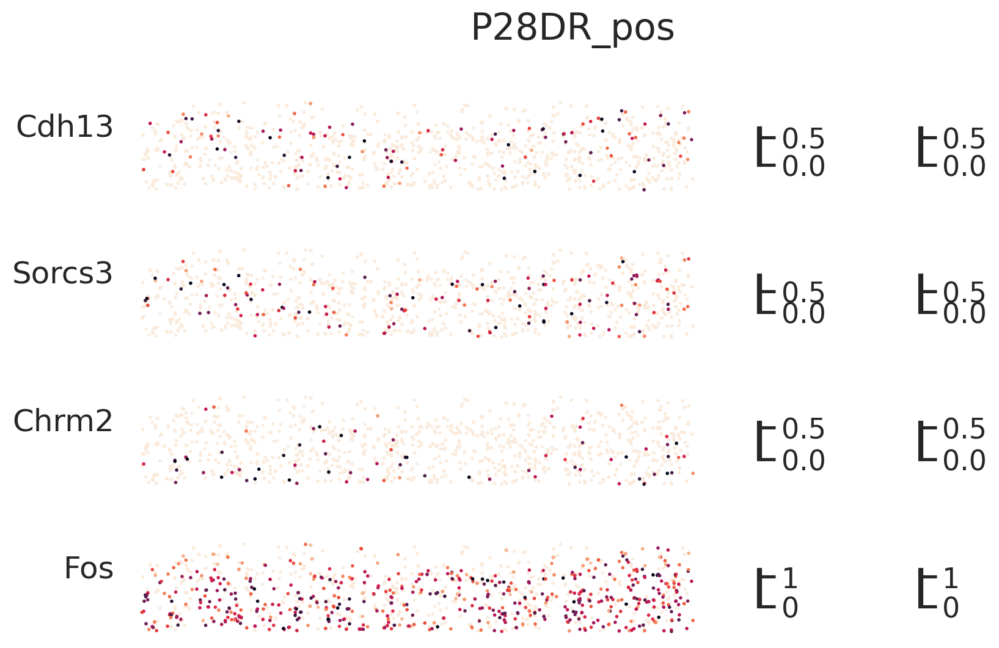

In [15]:
gns = ['Cdh13', 'Sorcs3', 'Chrm2', 'Fos']
for name in selected_sections: 
    adatasub = v1l23_data[name]
    x =  adatasub.obs['width']
    y = -adatasub.obs['depth']
    n = len(gns)
    # print(name)

    fig, axs = plt.subplots(n,1,figsize=(1*10,n*1.5))
    fig.suptitle(name)
    for ax, gn in zip(axs, gns):
        # gn = 'Scnn1a'
        g = np.log10(1+adatasub[:,gn].layers['norm']).reshape(-1,)

        vmax = np.percentile(g, 99)
        vmin = np.percentile(g,  5)
        cond = g > 1e-5

        utils_merfish.st_scatter_ax(fig, ax, x[~cond], y[~cond], gexp=g[~cond], s=4, title='', vmin=vmin, vmax=vmax, cmap='rocket_r') #, axis_off=False)
        utils_merfish.st_scatter_ax(fig, ax,  x[cond],  y[cond],  gexp=g[cond], s=4, title='', vmin=vmin, vmax=vmax, cmap='rocket_r') #, axis_off=False)

        ax.set_title(gn, loc='left', ha='right', y=0.5)
        # ax.grid(True)
        # ax.axis('on')

    plt.show()

# ABC genes

In [16]:
f = '/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results/MERFISH_gene_panel_Version1_March9.csv'
df1 = pd.read_csv(f)
f = '/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results/gene_ptime_P28_L23_Mar27.tsv'
df2 = pd.read_csv(f).sort_values('gene_ptime')
df = pd.merge(df1, df2, left_on='gene_name_data', right_on='gene').sort_values('gene_ptime')
genes_abco = df['gene_name_vizgen'].values
genes_abco.shape

(170,)

In [17]:
agenes = df[df['P17on_x']=='A']['gene_name_vizgen'].values
bgenes = df[df['P17on_x']=='B']['gene_name_vizgen'].values
cgenes = df[df['P17on_x']=='C']['gene_name_vizgen'].values
len(agenes), agenes, len(bgenes), bgenes, len(cgenes), cgenes

(64,
 array(['Met', '6530403H02Rik', 'Rhbdl3', 'Adamts2', 'Cdh13', 'Col23a1',
        'Vwc2l', 'Syt10', 'Kcnn3', 'Arhgef28', 'Pcdh19', 'Pakap', 'Ikzf2',
        'Nckap5', 'Dpyd', 'Gpc5', 'Slc6a7', 'Igsf11', 'Glis3', 'Ttc28',
        'Tenm1', 'Syt17', 'Robo1', 'Sema6a', 'Otof', 'Eda', 'Plxna1',
        'Tox3', 'Itga8', 'Kcnk13', 'Wnt4', 'Sdk2', 'Pdzrn4', 'Plxnd1',
        'Ryr3', 'Necab1', 'Camk2d', 'Iqgap2', 'Pdgfc', 'Gabrg3', 'Dscaml1',
        'Reln', 'Npas3', 'Cntn5', 'Rfx3', 'Grm1', 'Kirrel3', 'Nfib',
        'Fkbp5', 'Zfp608', 'Meis2', 'Mdga1', 'Tiam1', 'Grb14', 'Nkain3',
        'Epha6', 'Cacna1h', 'Pde1a', 'Nr3c2', 'Matn2', 'Tmem150c',
        'Adamts17', 'Ldb2', 'Egfem1'], dtype=object),
 35,
 array(['Grm8', 'Galnt17', 'Epha3', 'Rgs8', 'Sox5', 'Zfp804b', 'Tmeff1',
        'Fstl5', 'Cdh4', 'Kcnip3', 'Myh9', 'Sh3pxd2b', 'Klhl1', 'Trpc6',
        'Sema4a', 'Tafa1', 'Sertm1', 'Nrp1', 'Col26a1', 'Mas1', 'Igfn1',
        'Npas4', 'Scg3', 'Nptx2', 'Bdnf', 'Phf21b', 'Nell1', 'Baz1a',
 

In [18]:
agenes_idx = basicu.get_index_from_array(adatasub.var.index.values, agenes)
bgenes_idx = basicu.get_index_from_array(adatasub.var.index.values, bgenes)
cgenes_idx = basicu.get_index_from_array(adatasub.var.index.values, cgenes)

In [19]:
iegs = [
    'Fos',
    'Fosl2',
    'Nr4a1',
    'Egr1',
    'Nr4a2',
    'Nr4a3',
    'Crem',
    'Egr4',
    'Fosb',
    'Egr2',
    'Per1',
    'Junb',
    'Cebpb',
    'Klf4',
    'Atf3',
    'Klf2',
    'Maff',
    'Klf10',
    'Jund',
    'Mafk',
    'Srf',
    'Arc',
]

len(iegs)

22

In [20]:
igenes_idx = basicu.get_index_from_array(adatasub.var.index.values, iegs)
igenes_idx

array([ 44,  91,  61, 432,  77,  85, 397, 287,  11, 168,  42, 220, 240,
       330, 472, 232, 292, 247, 284,  34,  26,  56])

In [21]:
for name in selected_sections:
    adatasub = v1l23_data[name]
    adatasub.layers['lnorm'] = np.log10(1+adatasub.layers['norm']) # .sum(axis=1)

# stats

In [22]:
stats = {}
for name in selected_sections:
    adatasub = v1l23_data[name]
    lnorm_mean, lnorm_sem, lnorm_std, n, d, w, db, wb = binning_pipe(adatasub, n=8)
    stats[name] = (lnorm_mean, lnorm_sem, lnorm_std, n, d, w, db, wb)
d.value_counts()

(0.0, 42.857]          61
(42.857, 85.713]      103
(85.713, 128.57]      224
(128.57, 171.427]     212
(171.427, 214.283]    206
(214.283, 257.14]     220
(257.14, 299.997]     215
dtype: int64

In [23]:
# mean expression level across V1 L2/3 in NR
base_a0 = []
base_b0 = []
base_c0 = []
base_i0 = []
for name in ['P28NR_ant', 'P28NR_pos']:
    (lnorm_mean, lnorm_sem, lnorm_std, n, d, w, db, wb) = stats[name]
    base_a = np.mean(lnorm_mean.iloc[:,agenes_idx], axis=0) # across depth bins for each gene
    base_b = np.mean(lnorm_mean.iloc[:,bgenes_idx], axis=0) # across depth bins for each gene
    base_c = np.mean(lnorm_mean.iloc[:,cgenes_idx], axis=0) # across depth bins for each gene
    base_i = np.mean(lnorm_mean.iloc[:,igenes_idx], axis=0) # across depth bins for each gene
    
    base_a0.append(base_a)
    base_b0.append(base_b)
    base_c0.append(base_c)
    base_i0.append(base_i)
    
base_a0 = np.mean(base_a0, axis=0)
base_b0 = np.mean(base_b0, axis=0)
base_c0 = np.mean(base_c0, axis=0)
base_i0 = np.mean(base_i0, axis=0)

base_a0.shape, base_b0.shape, base_c0.shape, base_i0.shape

((64,), (35,), (71,), (22,))

In [24]:
means = {}
sems = {}
for name in selected_sections:
    (lnorm_mean, lnorm_sem, lnorm_std, n, d, w, db, wb) = stats[name]
    
    amean = np.mean(lnorm_mean.iloc[:,agenes_idx]-base_a0, axis=1) # a bin vector
    bmean = np.mean(lnorm_mean.iloc[:,bgenes_idx]-base_b0, axis=1) # a bin vector
    cmean = np.mean(lnorm_mean.iloc[:,cgenes_idx]-base_c0, axis=1) # a bin vector
    imean = np.mean(lnorm_mean.iloc[:,igenes_idx]-base_i0, axis=1) # a bin vector
    
    asem = np.mean(lnorm_sem.iloc[:,agenes_idx], axis=1)
    bsem = np.mean(lnorm_sem.iloc[:,bgenes_idx], axis=1)
    csem = np.mean(lnorm_sem.iloc[:,cgenes_idx], axis=1)
    isem = np.mean(lnorm_sem.iloc[:,igenes_idx], axis=1)
    
    means[name] = [amean, bmean, cmean, imean]
    sems[name] = [asem, bsem, csem, isem]
    

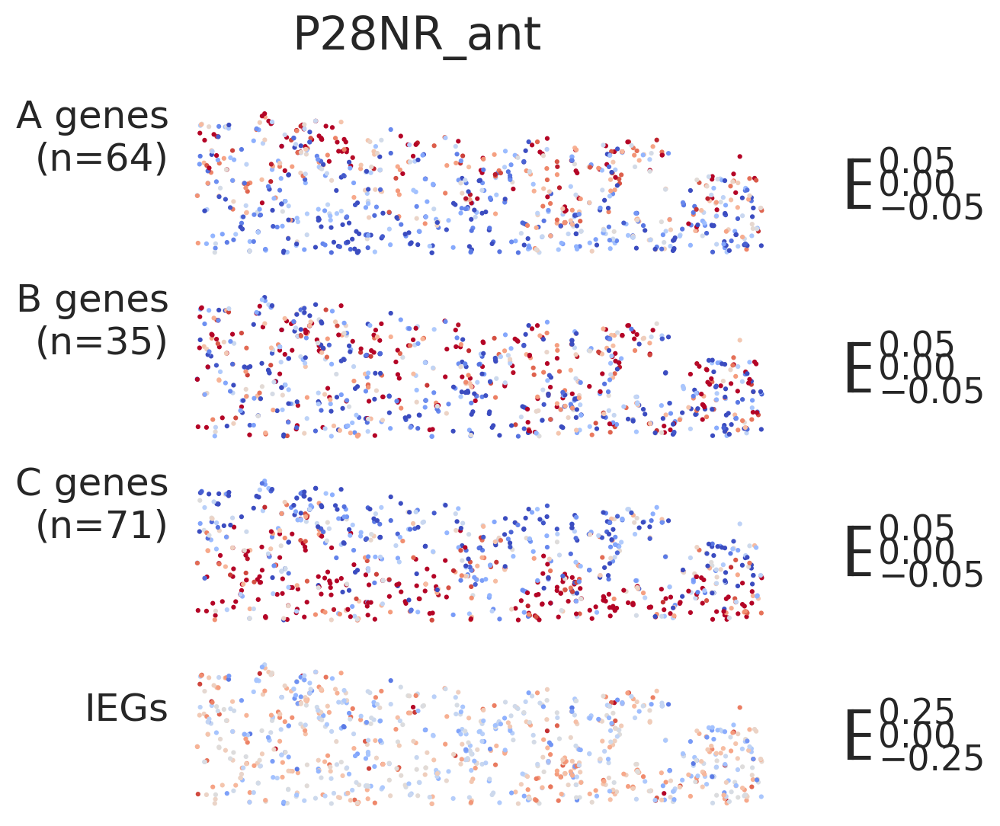

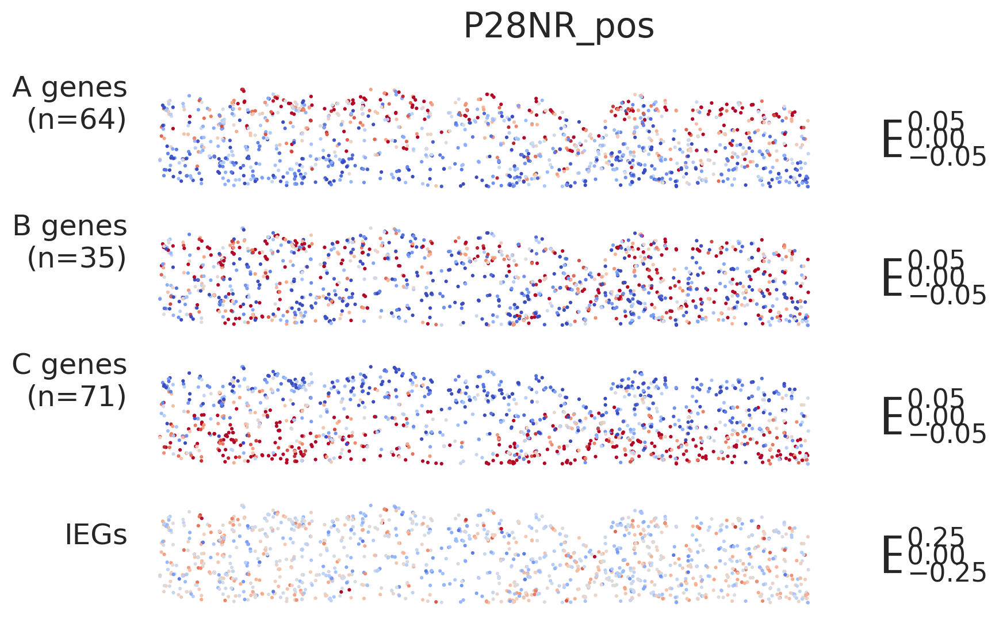

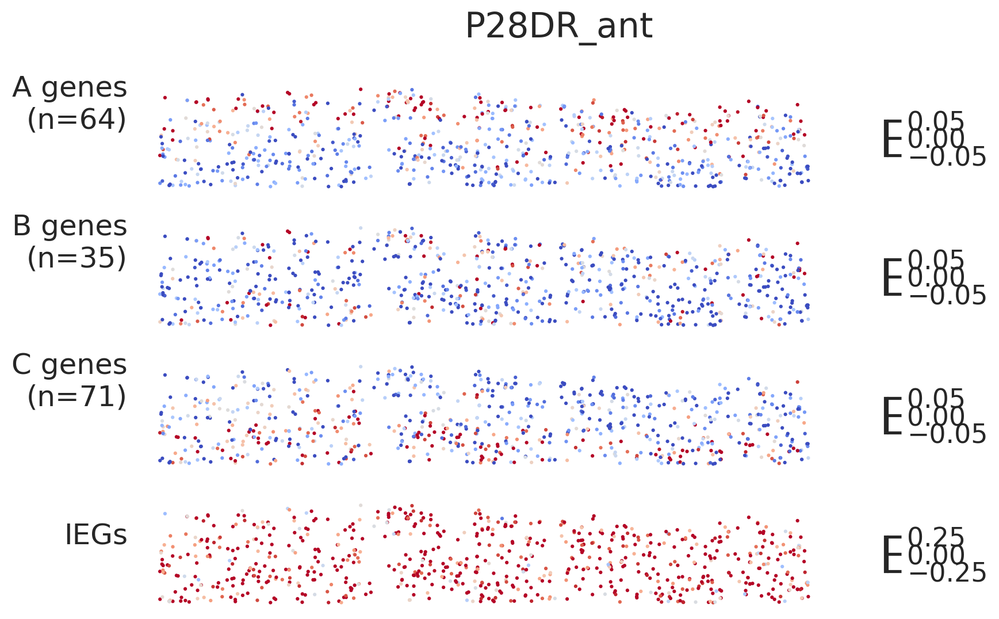

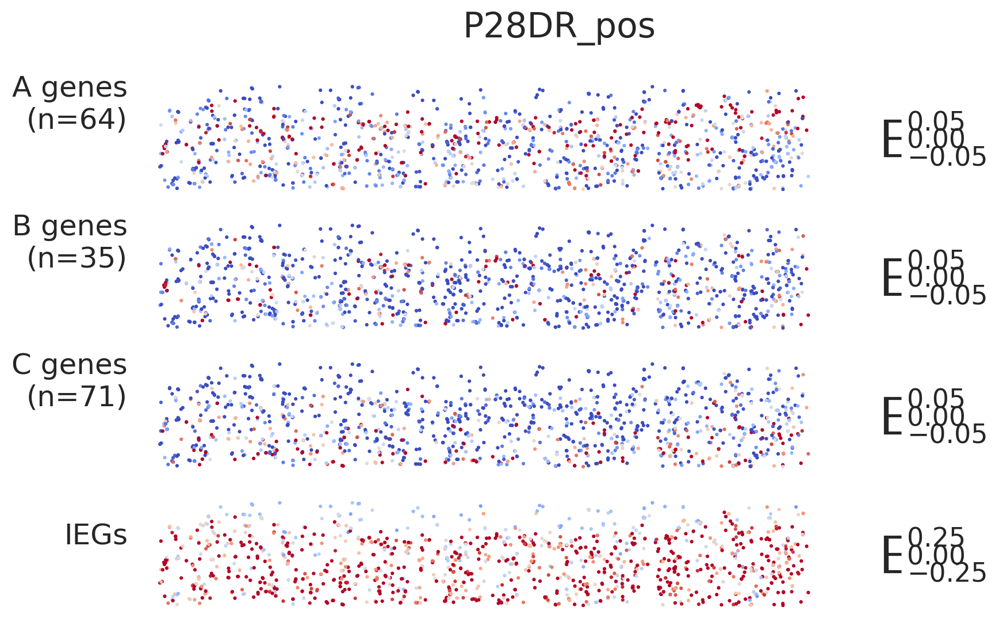

In [25]:
for name in selected_sections:
    adatasub = v1l23_data[name]
    
    depth = adatasub.obs['depth'].values
    width = adatasub.obs['width'].values
    mat   = adatasub.layers['lnorm']

    fig, axs = plt.subplots(4,1,figsize=(10,4*1.5))
    fig.suptitle(name)
    gnames = ['A genes\n(n=64)', 'B genes\n(n=35)', 'C genes\n(n=71)', 'IEGs']
    for i, (_idx, _baseline) in enumerate(zip([agenes_idx, bgenes_idx, cgenes_idx, igenes_idx], 
                                              [base_a0, base_b0, base_c0, base_i0])):
        ax = axs[i]
        lnorm_ = mat[:,_idx].copy()
        g = (lnorm_ - np.array(_baseline).reshape(1,-1)).mean(axis=1) 
        gn = gnames[i]
        if i < 3:
            vmax = +0.05 # np.percentile(g, 95)
            vmin = -0.05 # np.percentile(g,  0)
        else:
            vmax = +0.25 # np.percentile(g, 95)
            vmin = -0.25 # np.percentile(g,  0)

        utils_merfish.st_scatter_ax(fig, ax, width, -depth, gexp=g, s=5, title='', vmin=vmin, vmax=vmax, cmap='coolwarm') #, axis_off=False)
        ax.set_title(gn, loc='left', ha='right', y=0.5)
    plt.show()

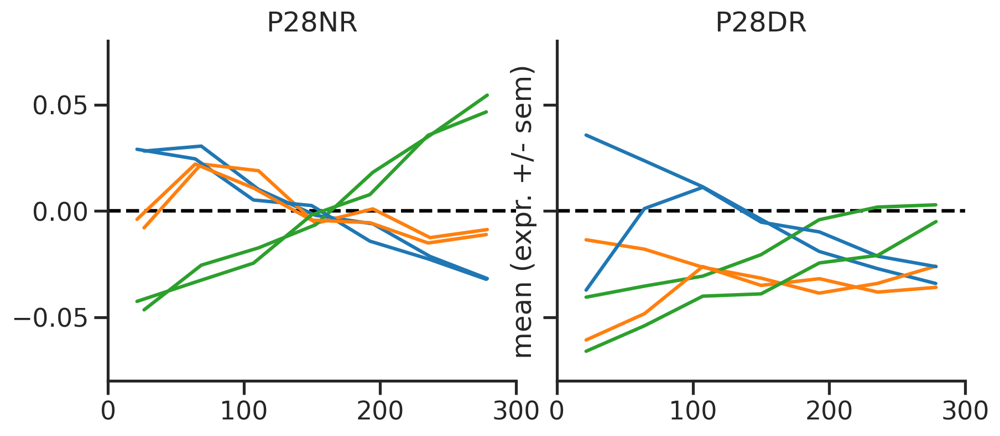

In [27]:
gnames = ['A genes (n=64)', 'B genes (n=35)', 'C genes (n=71)']

fig, axs = plt.subplots(1, 2, figsize=(5*2,4), sharex=True, sharey=True)

ax = axs[0]
ax.set_title('P28NR')
for name in ['P28NR_ant', 'P28NR_pos']:
    (lnorm_mean, lnorm_sem, lnorm_std, n, d, w, db, wb) = stats[name]
    amean, bmean, cmean, imean = means[name]
    asem, bsem, csem, isem = sems[name]
    
    x = np.mean(np.vstack([db[:-1], db[1:]]), axis=0)
    
    ax.plot(x, amean, label='A genes', color='C0', linestyle='-')
    # ax.fill_between(x, amean-asem, amean+asem, color='C0', alpha=0.1, edgecolor='none')
    ax.plot(x, bmean, label='B genes', color='C1', linestyle='-')
    # ax.fill_between(x, bmean-bsem, bmean+bsem, color='C1', alpha=0.1, edgecolor='none')
    ax.plot(x, cmean, label='C genes', color='C2', linestyle='-')
    # ax.fill_between(x, cmean-csem, cmean+csem, color='C2', alpha=0.1, edgecolor='none')
    ax.axhline(color='k', linestyle='--', zorder=1)

sns.despine(ax=ax)
ax.set_ylim([-0.08, 0.08])
ax.set_xticks([0, 100, 200, 300])
ax.grid(False)

ax = axs[1]
ax.set_title('P28DR')
for name in ['P28DR_ant', 'P28DR_pos']:
    (lnorm_mean, lnorm_sem, lnorm_std, n, d, w, db, wb) = stats[name]
    amean, bmean, cmean, imean = means[name]
    asem, bsem, csem, isem = sems[name]
    
    x = np.mean(np.vstack([db[:-1], db[1:]]), axis=0)
    
    ax.plot(x, amean, label='A genes', color='C0', linestyle='-')
    # ax.fill_between(x, amean-asem, amean+asem, color='C0', alpha=0.1, edgecolor='none')
    ax.plot(x, bmean, label='B genes', color='C1', linestyle='-')
    # ax.fill_between(x, bmean-bsem, bmean+bsem, color='C1', alpha=0.1, edgecolor='none')
    ax.plot(x, cmean, label='C genes', color='C2', linestyle='-')
    # ax.fill_between(x, cmean-csem, cmean+csem, color='C2', alpha=0.1, edgecolor='none')
    ax.axhline(color='k', linestyle='--', zorder=1)

sns.despine(ax=ax)
ax.set_ylim([-0.08, 0.08])
ax.set_xticks([0, 100, 200, 300])
ax.grid(False)

    
ax.set_ylabel('mean (expr. +/- sem)')
fig.subplots_adjust(wspace=0.1)
# powerplots.savefig_autodate(fig, outdatadir+'/grant_saumya_lineq_abc_v3.pdf')

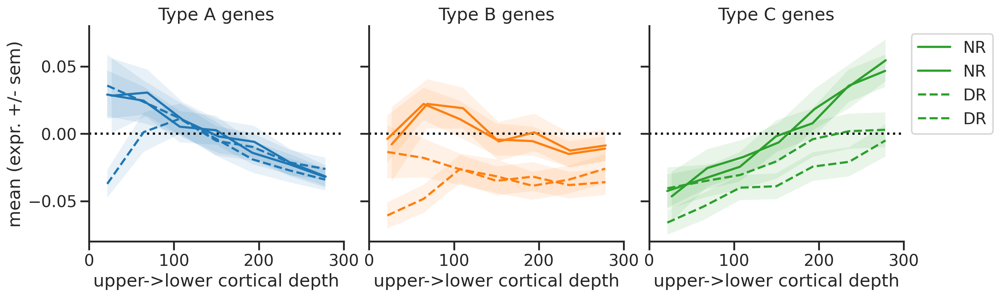

In [28]:
gnames = ['Type A genes', 'Type B genes', 'Type C genes']

fig, axs = plt.subplots(1, 3, figsize=(5*3,4), sharex=True, sharey=True)

for i in range(3):
    ax = axs[i]
    sns.despine(ax=ax)
    ax.set_title(gnames[i])
    ax.grid(False)
    color = f'C{i}'
    
    for name in ['P28NR_ant', 'P28NR_pos']:
        (lnorm_mean, lnorm_sem, lnorm_std, n, d, w, db, wb) = stats[name]
        mean_vec = means[name][i]
        sem_vec = sems[name][i]

        x = np.mean(np.vstack([db[:-1], db[1:]]), axis=0)
        ax.plot(x, mean_vec, label='NR', color=color, linestyle='-')
        ax.fill_between(x, mean_vec-sem_vec, mean_vec+sem_vec, color=color, alpha=0.1, edgecolor='none')
    
    for name in ['P28DR_ant', 'P28DR_pos']:
        (lnorm_mean, lnorm_sem, lnorm_std, n, d, w, db, wb) = stats[name]
        mean_vec = means[name][i]
        sem_vec = sems[name][i]

        x = np.mean(np.vstack([db[:-1], db[1:]]), axis=0)
        ax.plot(x, mean_vec, label='DR', color=color, linestyle='--')
        ax.fill_between(x, mean_vec-sem_vec, mean_vec+sem_vec, color=color, alpha=0.1, edgecolor='none')
        
    ax.set_ylim([-0.08, 0.08])
    ax.axhline(color='k', linestyle='dotted', zorder=1)
    ax.set_xticks([0, 100, 200, 300])
    ax.set_xlabel('upper->lower cortical depth')
    
axs[0].set_ylabel('mean (expr. +/- sem)')
axs[2].legend(bbox_to_anchor=(1,1))

fig.subplots_adjust(wspace=0.1)
# powerplots.savefig_autodate(fig, outdatadir+'/grant_saumya_lineq_abc_v3.pdf')

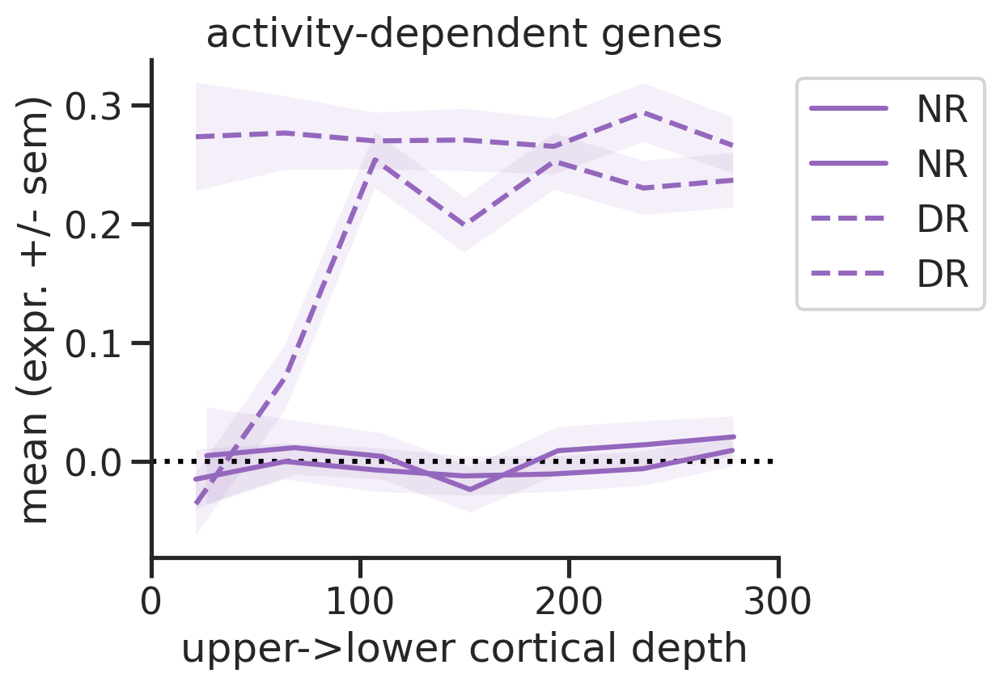

In [29]:
gnames = ['activity-dependent genes',]

fig, ax = plt.subplots(1, 1, figsize=(5*1,4))

i = 3
color = f'C4'

sns.despine(ax=ax)
ax.set_title(gnames[0])
ax.grid(False)

for name in ['P28NR_ant', 'P28NR_pos']:
    (lnorm_mean, lnorm_sem, lnorm_std, n, d, w, db, wb) = stats[name]
    mean_vec = means[name][i]
    sem_vec = sems[name][i]

    x = np.mean(np.vstack([db[:-1], db[1:]]), axis=0)
    ax.plot(x, mean_vec, label='NR', color=color, linestyle='-')
    ax.fill_between(x, mean_vec-sem_vec, mean_vec+sem_vec, color=color, alpha=0.1, edgecolor='none')

for name in ['P28DR_ant', 'P28DR_pos']:
    (lnorm_mean, lnorm_sem, lnorm_std, n, d, w, db, wb) = stats[name]
    mean_vec = means[name][i]
    sem_vec = sems[name][i]

    x = np.mean(np.vstack([db[:-1], db[1:]]), axis=0)
    ax.plot(x, mean_vec, label='DR', color=color, linestyle='--')
    ax.fill_between(x, mean_vec-sem_vec, mean_vec+sem_vec, color=color, alpha=0.1, edgecolor='none')

# ax.set_ylim([-0.08, 0.08])
ax.axhline(color='k', linestyle='dotted', zorder=1)
ax.set_xticks([0, 100, 200, 300])
ax.set_xlabel('upper->lower cortical depth')
    
ax.set_ylabel('mean (expr. +/- sem)')
ax.legend(bbox_to_anchor=(1,1))

fig.subplots_adjust(wspace=0.1)
# powerplots.savefig_autodate(fig, outdatadir+'/grant_saumya_lineq_abc_v3.pdf')

# V1 vs outside of V1